# Basic dependencies & imports

In [3]:
# Cell 1: imports

import os
import re
import random
from copy import deepcopy
from io import BytesIO
from pathlib import Path
from typing import Any, AsyncIterable, Callable, Dict, Generator, List, NamedTuple, Optional, Tuple, Union

import numpy as np
import pandas as pd
import torch
from PIL import Image
import requests
from safetensors.torch import load_file
from accelerate import infer_auto_device_map, load_checkpoint_and_dispatch, init_empty_weights
from peft import PeftConfig, PeftModel, LoraConfig, get_peft_model

from data.transforms import ImageTransform
from data.data_utils_token import add_special_tokens
from modeling.bagel import (
    BagelConfig,
    Bagel,
    Qwen2Config,
    Qwen2ForCausalLM,
    SiglipVisionConfig,
    SiglipVisionModel,
)
from modeling.qwen2 import Qwen2Tokenizer
from modeling.bagel.qwen2_navit import NaiveCache
from modeling.autoencoder import load_ae
from inferencer import InterleaveInferencer  

print("Imports finished.")


/home/fi-lib/anaconda3/envs/bagel/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Imports finished.


# Paths & configuration

In [ ]:
# Cell 2: Config (set paths & inference hyperparameters)

config = {
    # ===== Paths =====
    # Use relative paths whenever possible for portability.
    # Users can modify these paths after cloning the repository.
    "parquet_path": "./data/SIGMA-dataset/seedxedit_multi/test/style_relation.parquet",
    "model_path": "./models/BAGEL-7B-MoT",
    "ema_model_path": "./models/SIGMA",  # or a specific checkpoint directory
    "output_dir": "./results/demo/",

    # ===== Resource & mode switches =====
    "max_mem_per_gpu": "50GiB",
    "use_lora": False,      # LoRA is disabled by default in this demo
    "visual_gen": True,     # enable image generation
    "visual_und": False,    # enable visual understanding if needed

    # ===== Inference hyperparameters =====
    # You may tune these values for different tasks or datasets
    "seed": 42,
    "inference_hyper": dict(
        cfg_text_scale=4.0,
        cfg_img_scale=2.0,
        cfg_interval=[0.0, 1.0],
        timestep_shift=3.0,
        num_timesteps=50,
        cfg_renorm_min=0.0,
        cfg_renorm_type="text_channel",
    ),
}

# Create output directory if it does not exist
Path(config["output_dir"]).mkdir(parents=True, exist_ok=True)

print("Config initialized.")
for k, v in config.items():
    if isinstance(v, (str, int, float, bool)):
        print(f"  {k}: {v}")


Config initialized.
  parquet_path: /fi-lib/workspace/zxy/data/A_benchmark/our_parquet/token_parquet/style_relation.parquet
  model_path: /fi-lib/workspace/zxy/code/Bagel_lora/BAGEL-7B-MoT
  ema_model_path: /fi-lib/workspace/zxy/code/Bagel_lora/results/all_special_select_lr00002_interleave_specialtoken_cosine_nolora_new/checkpoints/0050000
  output_dir: /fi-lib/workspace/zxy/code/Bagel_lora_copy/results_test/style_relation_less
  max_mem_per_gpu: 50GiB
  use_lora: False
  visual_gen: True
  visual_und: False
  seed: 42


# Utility functions

In [ ]:
# Cell 3: utility functions

from pathlib import Path

def safe_save(img: Image.Image, out_path: str) -> str:
    """
    Safely save an image to disk.

    - 16-bit grayscale images are always saved as PNG.
    - For JPEG outputs, unsupported image modes are converted to RGB.
    """
    p = Path(out_path)

    # Handle 16-bit grayscale images
    if img.mode in ("I;16", "I;16B", "I;16L"):
        if p.suffix.lower() in (".jpg", ".jpeg"):
            p = p.with_suffix(".png")
        img.save(p)
        return str(p)

    # Handle other image modes
    if p.suffix.lower() in (".jpg", ".jpeg") and img.mode not in ("L", "RGB"):
        img = img.convert("RGB")

    img.save(p)
    return str(p)


def set_seed(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    print(f"Random seed set to {seed}.")


set_seed(config["seed"])


Random seed set to 42.


# Model & Inferencer initialization

In [ ]:
# Cell 4: model & inferencer initialization

def initialize_model_and_inferencer(
    model_path: str,
    ema_model_path: str,
    max_mem_per_gpu: str,
    use_lora: bool,
    visual_und: bool,
    visual_gen: bool,
):
    # LLM config
    llm_config = Qwen2Config.from_json_file(os.path.join(model_path, "llm_config.json"))
    llm_config.qk_norm = True
    llm_config.tie_word_embeddings = False
    llm_config.layer_module = "Qwen2MoTDecoderLayer"

    # Tokenizer
    tokenizer = Qwen2Tokenizer.from_pretrained(model_path)
    tokenizer, new_token_ids, _ = add_special_tokens(tokenizer)

    # ViT config
    vit_config = SiglipVisionConfig.from_json_file(os.path.join(model_path, "vit_config.json"))
    vit_config.rope = False
    vit_config.num_hidden_layers = vit_config.num_hidden_layers - 1

    # VAE
    vae_model, vae_config = load_ae(local_path=os.path.join(model_path, "ae.safetensors"))

    # Bagel config
    config_bagel = BagelConfig(
        visual_gen=visual_gen,
        visual_und=visual_und,
        llm_config=llm_config,
        vit_config=vit_config,
        vae_config=vae_config,
        vit_max_num_patch_per_side=70,
        connector_act="gelu_pytorch_tanh",
        latent_patch_size=2,
        max_latent_size=64,
    )

    print(f"use_lora: {use_lora}")
    print(f"visual_und: {visual_und}, visual_gen: {visual_gen}")

   
    with init_empty_weights():
        language_model = Qwen2ForCausalLM(llm_config)
        vit_model = SiglipVisionModel(vit_config)
        model = Bagel(language_model, vit_model, config_bagel)
        if visual_und:
            model.vit_model.vision_model.embeddings.convert_conv2d_to_linear(vit_config, meta=True)
        if use_lora:
            lora_config = LoraConfig(
                r=8,
                lora_alpha=32,
                target_modules="all-linear",
                lora_dropout=0.05,
                bias="none",
                task_type="CAUSAL_LM",
            )
            model = get_peft_model(model, lora_config)

    # Transforms
    vae_transform = ImageTransform(1024, 512, 16)
    vit_transform = ImageTransform(980, 224, 14)


    TARGET_GPU = "cuda:5"

    # Device map: accelerate will propose a split, then we override it
    device_map = infer_auto_device_map(
        model,
        max_memory={i: max_mem_per_gpu for i in range(torch.cuda.device_count())},
        no_split_module_classes=["Bagel", "Qwen2MoTDecoderLayer"],
    )

    # Override ALL modules to TARGET_GPU
    for k in device_map.keys():
        device_map[k] = TARGET_GPU

    # Ensure specific modules stay together
    for k in [
        "language_model.model.embed_tokens",
        "time_embedder",
        "latent_pos_embed",
        "vae2llm",
        "llm2vae",
        "connector",
        "vit_pos_embed",
    ]:
        device_map[k] = TARGET_GPU

    print("Using forced device:", TARGET_GPU)

    # Load model weights
    if use_lora:
        ckpt_path = os.path.join(ema_model_path, "model.safetensors")
    else:
        ckpt_path = os.path.join(ema_model_path, "ema.safetensors")

    print(f"Loading checkpoint from: {ckpt_path}")

    model = load_checkpoint_and_dispatch(
        model,
        checkpoint=ckpt_path,
        device_map=device_map,
        offload_buffers=True,
        dtype=torch.bfloat16,
        force_hooks=True,
        offload_folder="/tmp/offload",
    )

    in_emb = model.language_model.get_input_embeddings().weight.shape[0]
    out_emb = model.language_model.get_output_embeddings().weight.shape[0]
    print("len(tokenizer) =", len(tokenizer), "in_emb =", in_emb, "out_emb =", out_emb)


    model = model.eval()
    print("Model loaded.")

    inferencer = InterleaveInferencer(
        model=model,
        vae_model=vae_model,
        tokenizer=tokenizer,
        vae_transform=vae_transform,
        vit_transform=vit_transform,
        new_token_ids=new_token_ids,
    )
    return inferencer



inferencer = initialize_model_and_inferencer(
    model_path=config["model_path"],
    ema_model_path=config["ema_model_path"],
    max_mem_per_gpu=config["max_mem_per_gpu"],
    use_lora=config["use_lora"],
    visual_und=config["visual_und"],
    visual_gen=config["visual_gen"],
)


use_lora: False
visual_und: False, visual_gen: True


The safetensors archive passed at /fi-lib/workspace/zxy/code/Bagel_lora/results/all_special_select_lr00002_interleave_specialtoken_cosine_nolora_new/checkpoints/0050000/ema.safetensors does not contain metadata. Make sure to save your model with the `save_pretrained` method. Defaulting to 'pt' metadata.


Using forced device: cuda:5
Loading checkpoint from: /fi-lib/workspace/zxy/code/Bagel_lora/results/all_special_select_lr00002_interleave_specialtoken_cosine_nolora_new/checkpoints/0050000/ema.safetensors


/home/fi-lib/anaconda3/envs/bagel/lib/python3.10/site-packages/accelerate/utils/modeling.py:1614: UserWarning: The following device_map keys do not match any submodules in the model: ['connector', 'vit_pos_embed']
  warnings.warn(


len(tokenizer) = 151695 in_emb = 152064 out_emb = 152064
Model loaded.


# Single-sample generation 

In [ ]:
# Cell 5: Generate one sample from image paths + prompt

from typing import List, Dict, Any
from IPython.display import display


def generate_image_from_inputs(
    prompt: str,
    image_paths: List[str],
    inferencer: InterleaveInferencer,
    output_dir: str,
    inference_hyper: Dict[str, Any],
    sample_name: str = "demo_sample",
    save_inputs: bool = True,
):
    """
    Run inference using a text prompt and a list of input images, and save the result.

    Args:
        prompt (str): Text instruction.
        image_paths (List[str]):
            List of paths to conditioning images.
            The order matters (e.g., [STYLE_BASE, STYLE_REF, EDIT_BASE, ...]).
        inferencer (InterleaveInferencer): An initialized interleaved inferencer.
        output_dir (str): Directory to save outputs.
        inference_hyper (Dict[str, Any]): Inference hyperparameters (e.g., CFG scales).
        sample_name (str): Prefix for output file names.
        save_inputs (bool): Whether to copy input images to the output directory.
    """
    Path(output_dir).mkdir(parents=True, exist_ok=True)

    # 1) (Optional) Save the prompt
    instr_path = os.path.join(output_dir, f"{sample_name}_instruction.txt")
    # Uncomment if you want to save the prompt text
    # with open(instr_path, "w", encoding="utf-8") as f:
    #     f.write(prompt)

    # 2) Load input images
    pil_images = []
    for idx, p in enumerate(image_paths):
        img = Image.open(p).convert("RGB")
        pil_images.append(img)

        if save_inputs:
            in_path = os.path.join(output_dir, f"{sample_name}_img_{idx}.jpg")
            # Uncomment to save input images
            # safe_save(img, in_path)

    # 3) Construct interleaved input: [prompt, img1, img2, ...]
    input_list = [prompt] + pil_images

    # 4) Run inference
    output_dict = inferencer.interleave_inference(
        input_lists=input_list,
        **inference_hyper,
    )
    generated_img = output_dict[0]

    # 5) Save generated result
    gen_path = os.path.join(output_dir, f"{sample_name}_img_generated.jpg")
    generated_img.save(gen_path)
    print(f"Saved generated image -> {gen_path}")

    # 6) Display results in the notebook
    print("\n=== Input images ===")
    for img in pil_images:
        display(img)

    print("\n=== Generated image ===")
    display(generated_img)

    return generated_img


100%|██████████| 49/49 [01:58<00:00,  2.42s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/select_img_generated.jpg

=== Input images ===


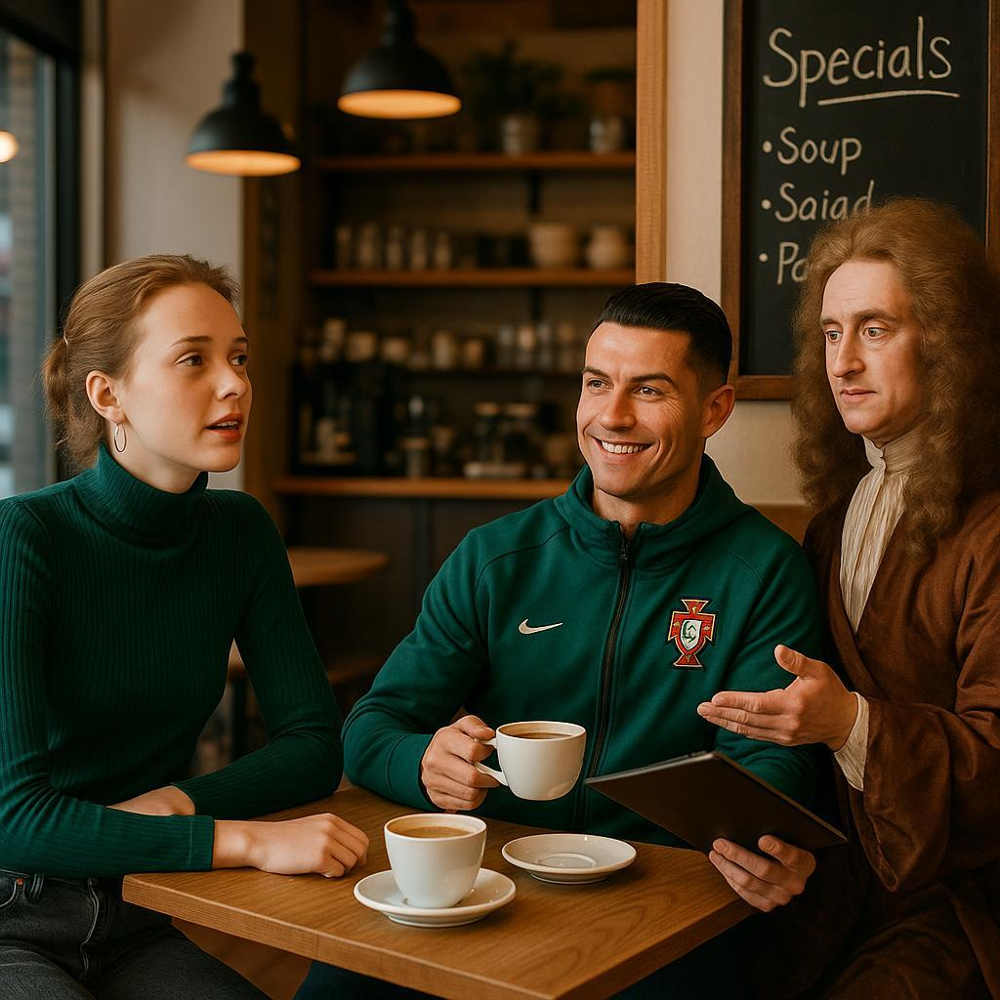


=== Generated image ===


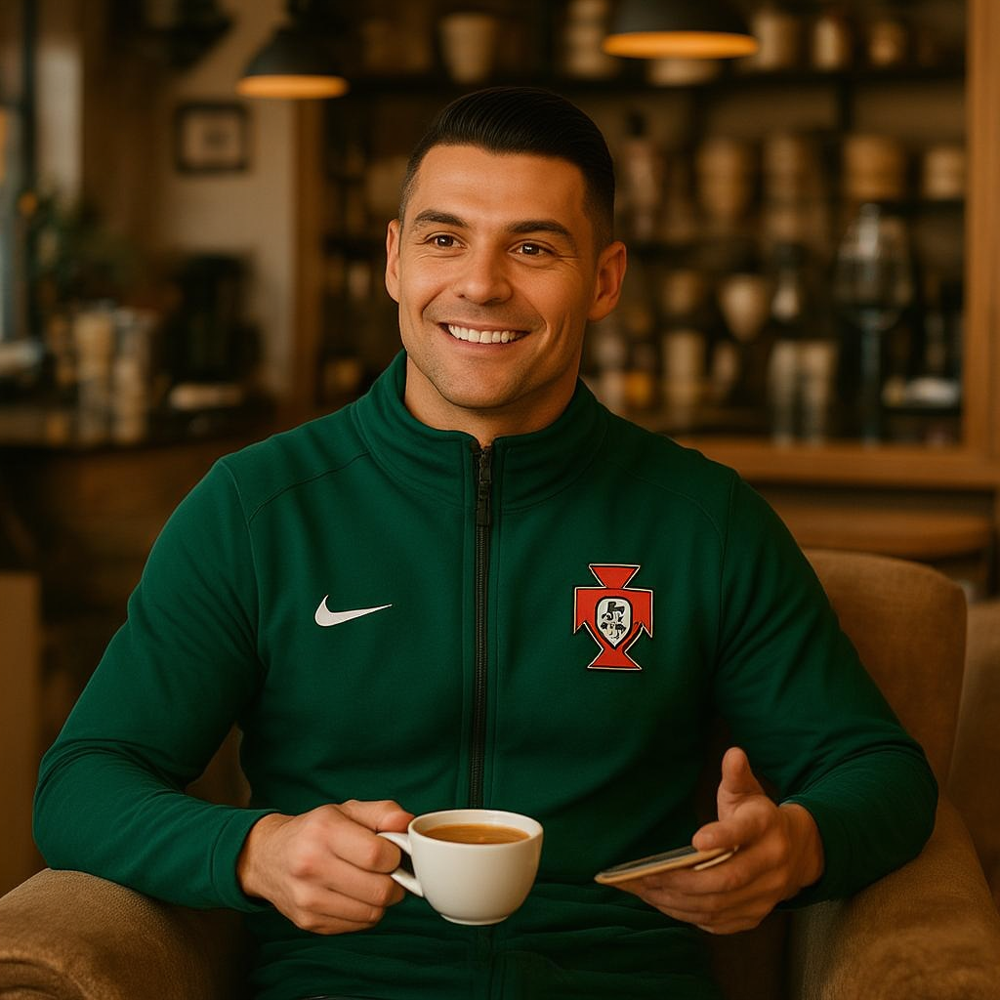

In [ ]:
# Cell 6: define a demo task (manually specify image paths + prompt)

# Example: one or more reference images + a text prompt
# Adjust the image paths according to your task type.
# All paths should be relative to the project root.

image_paths = [
    "./samples/multi_people.jpg",  
    # You may add more images here, such as EDIT_BASE, REF_TARGET, etc.
]

prompt = "Select the <select>man on the center from <image_1>."

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="select",
)


100%|██████████| 49/49 [01:55<00:00,  2.35s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/style_transfer_img_generated.jpg

=== Input images ===


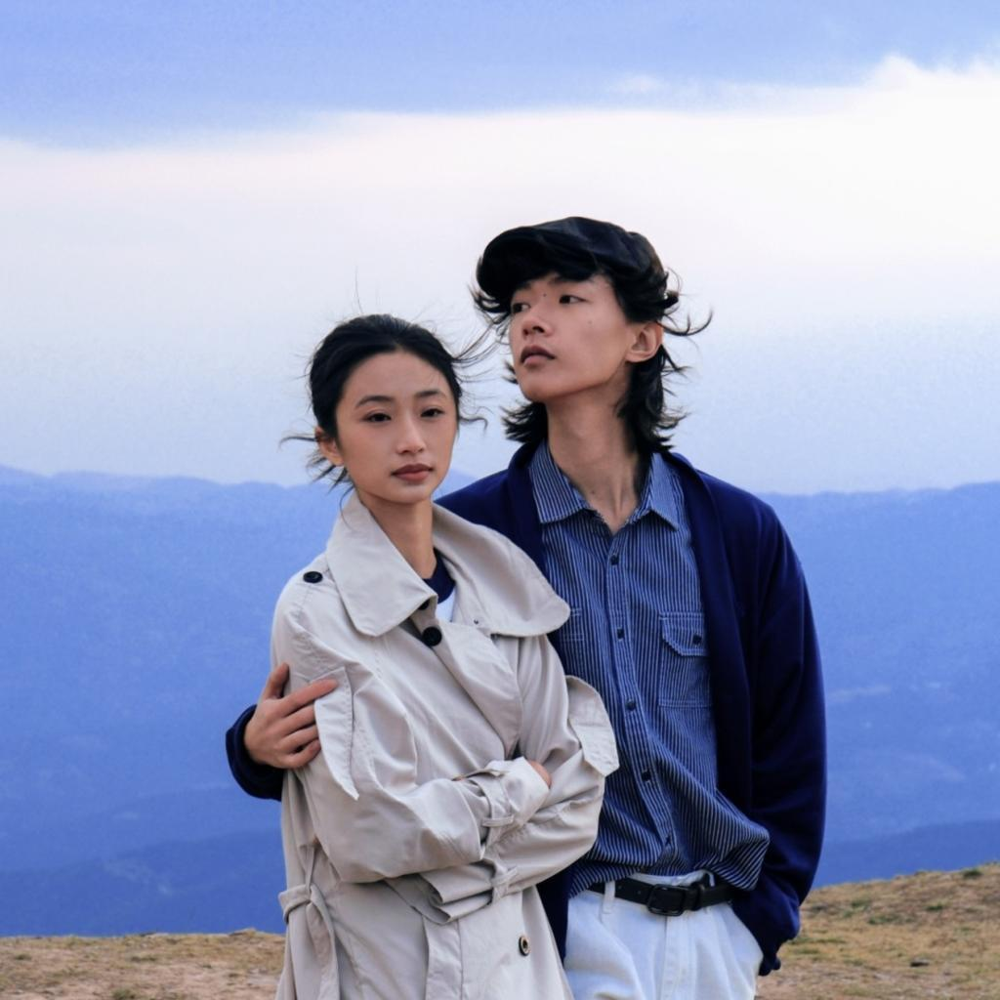

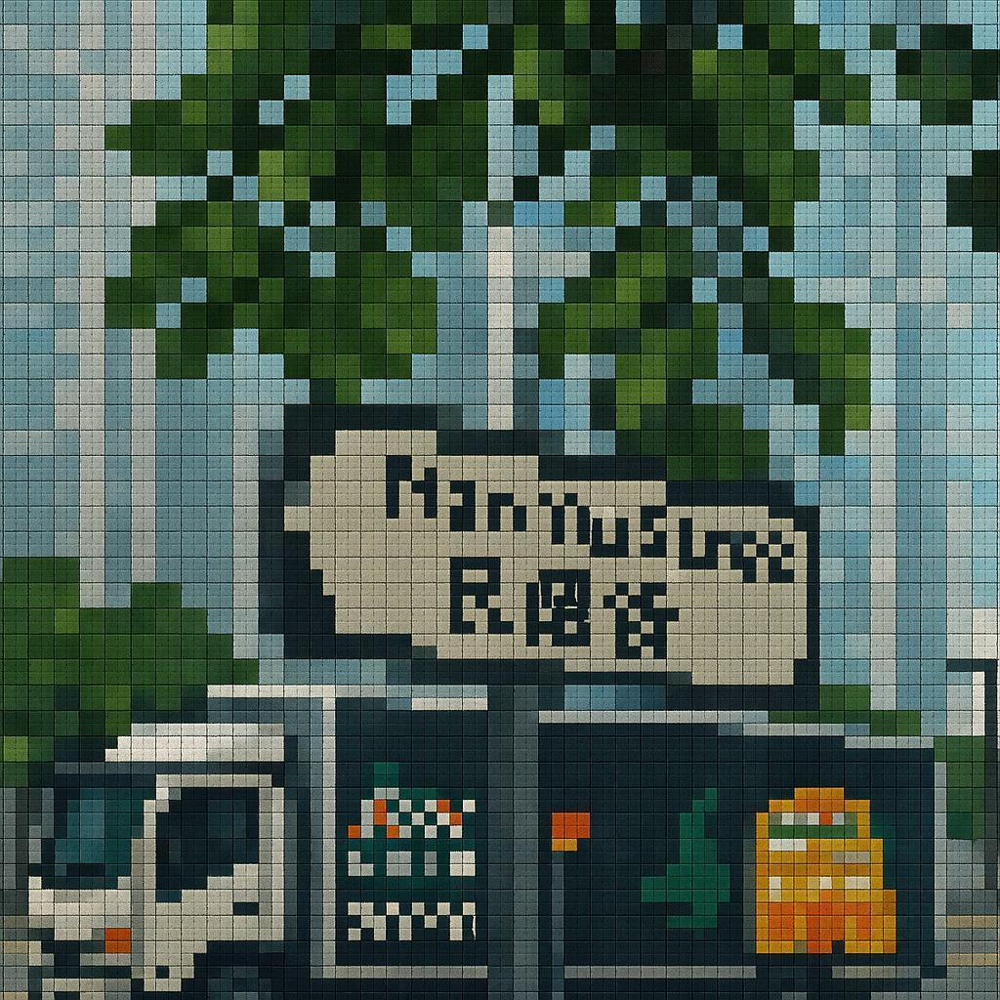


=== Generated image ===


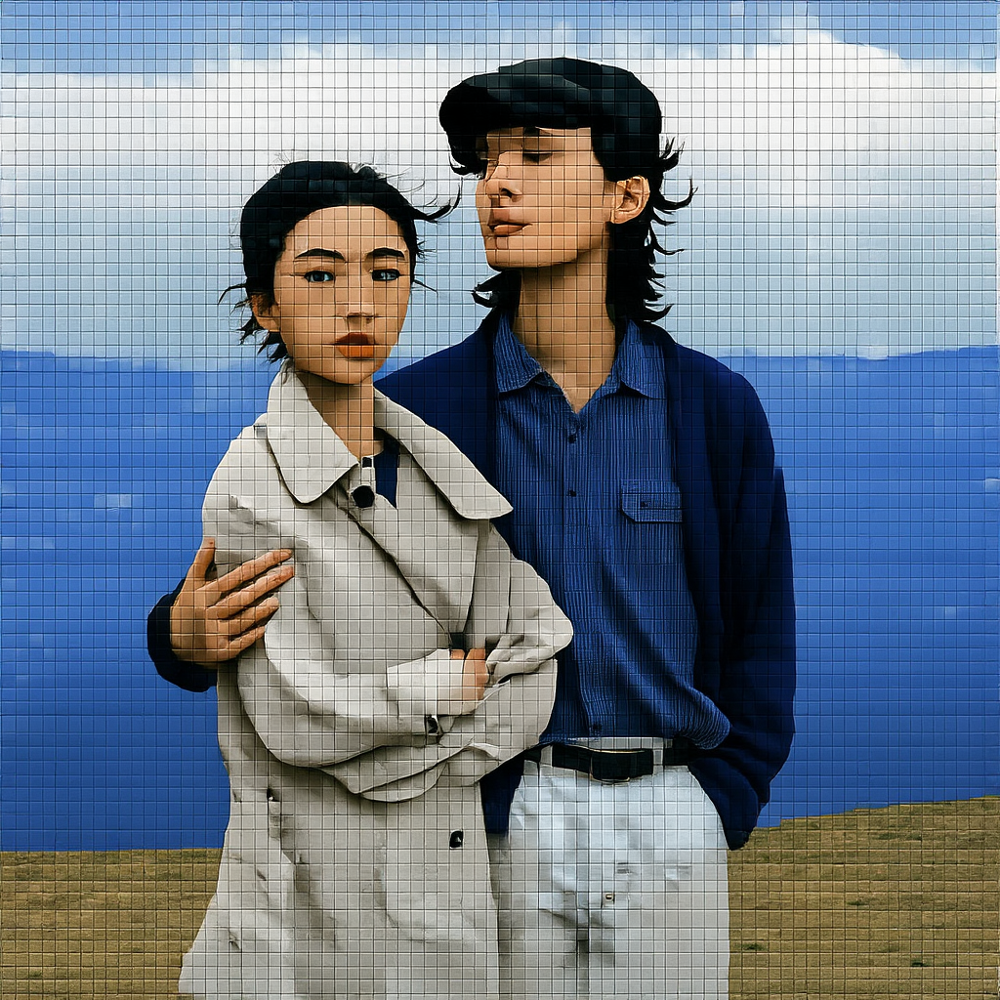

In [ ]:
# Cell 7: define a demo task (manually specify image paths + prompt)

image_paths = [
    "./samples/test_sample36_img_0.jpg",
    "./samples/test_sample36_img_1.jpg",
]

prompt = "Generate a stylized image by transforming the given content image <image_1> with the <style>style of the provided style image <image_2>."

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="style_transfer",
)


100%|██████████| 49/49 [02:14<00:00,  2.75s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/style_transfer1_img_generated.jpg

=== Input images ===


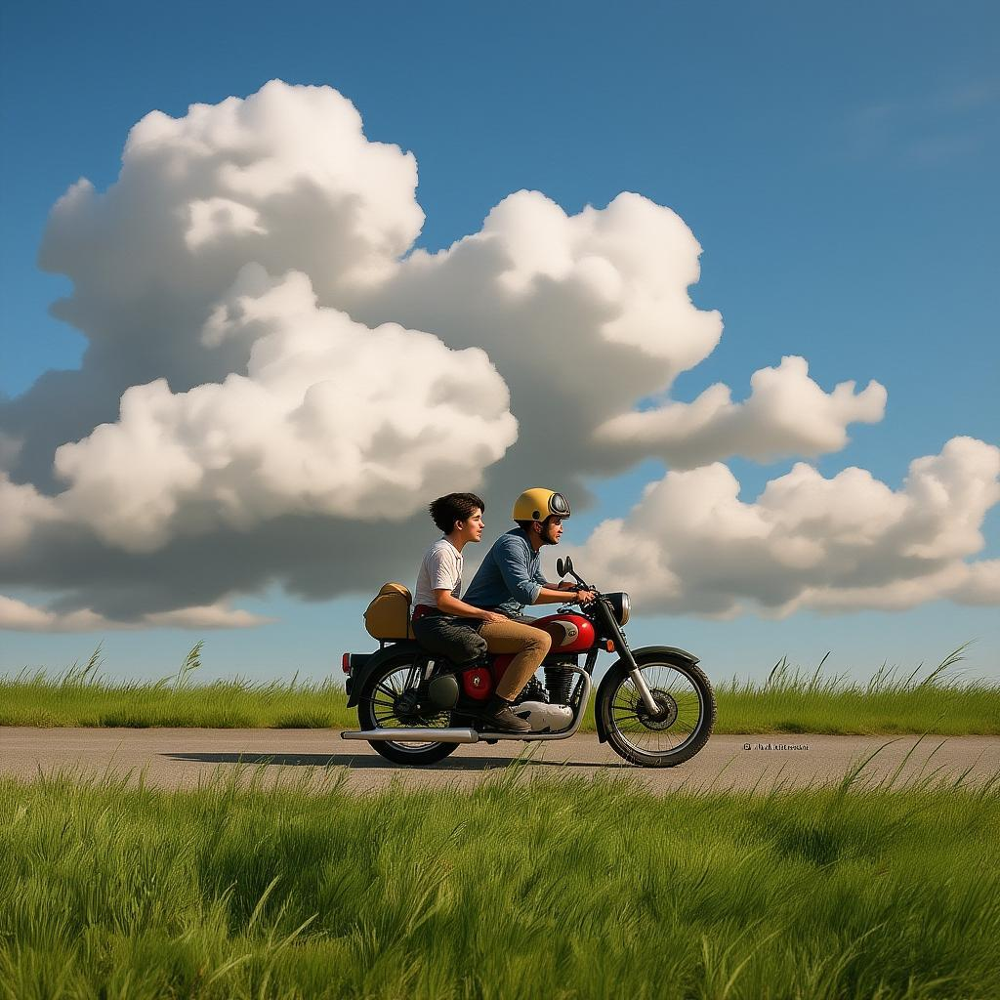

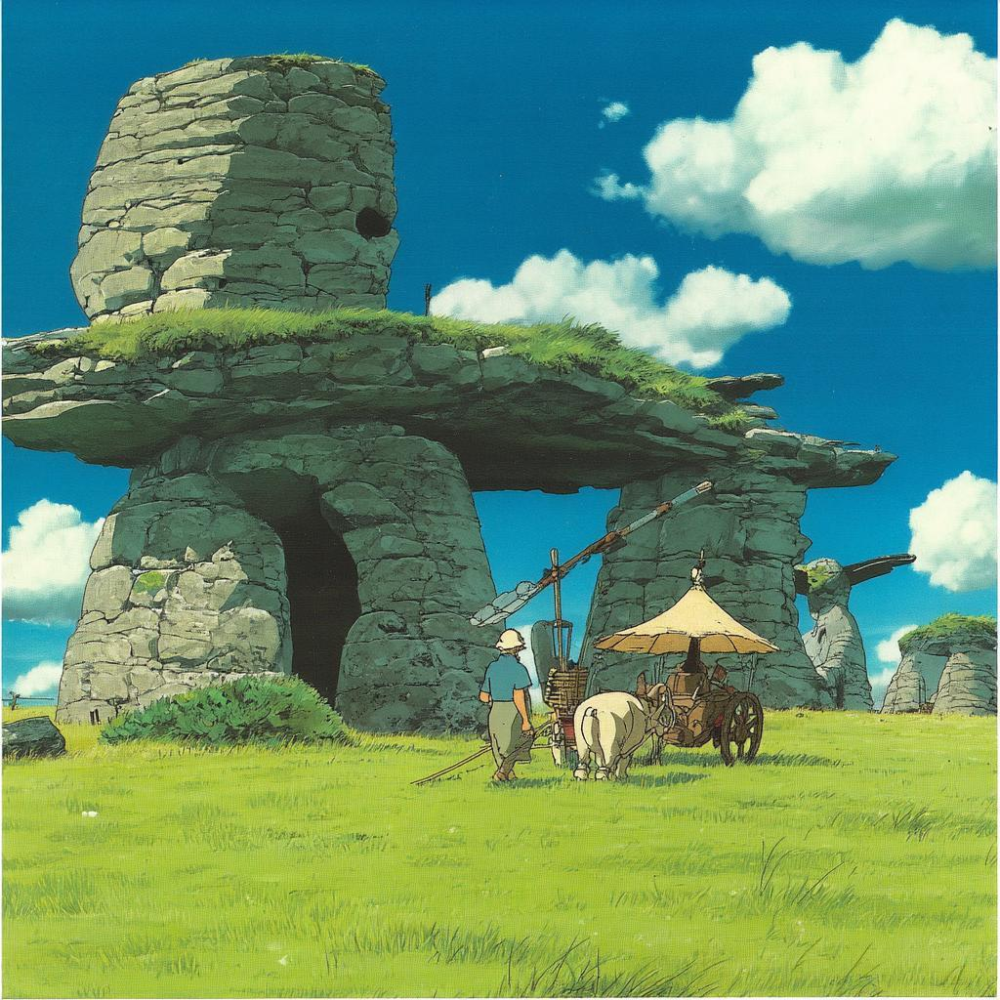


=== Generated image ===


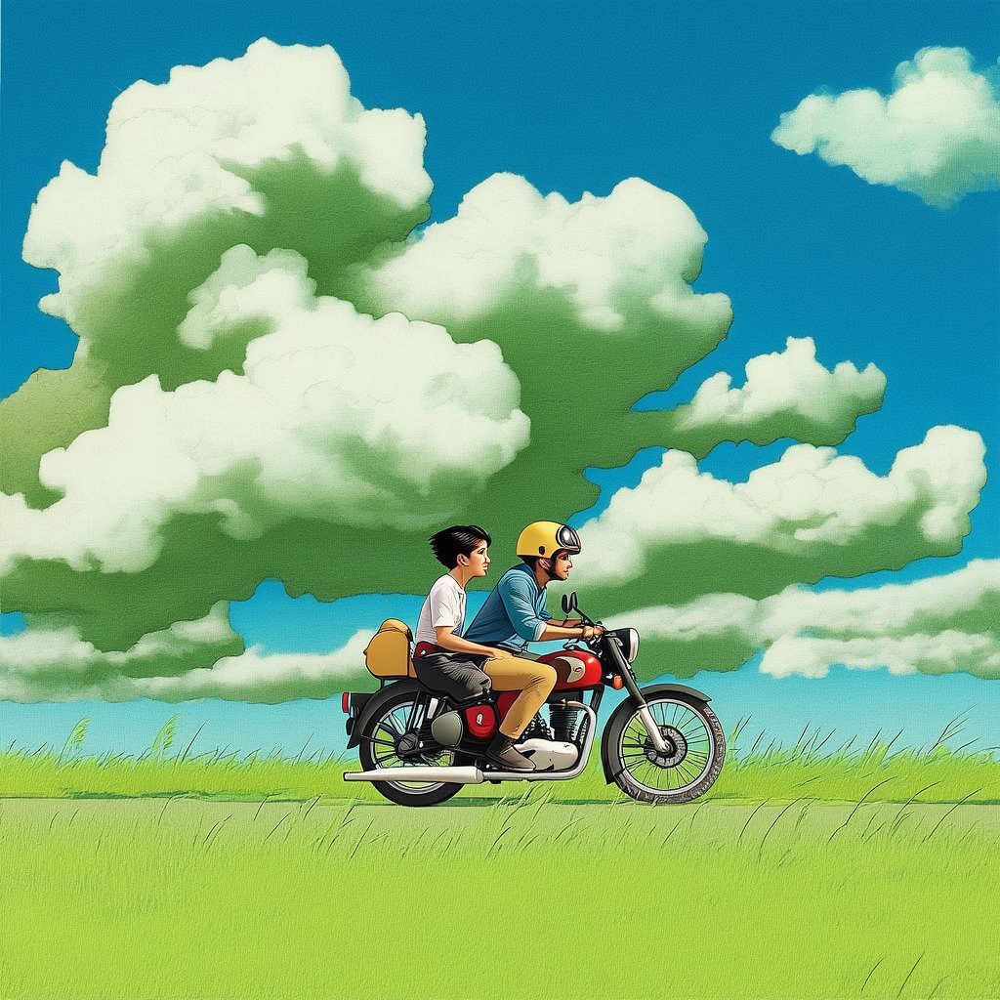

In [ ]:
# Cell 7: define a demo task (manually specify image paths + prompt)

# 举例：两张参考图 + 一个 prompt
# 你按自己的 SIGMA 任务类型，把路径改成相对路径就行
image_paths = [
    "./A_benchmark/style_transfer/test_sample45_img_0.jpg",  # 比如 STYLE_BASE
    "./A_benchmark/style_transfer/test_sample45_img_2.jpg",

]

prompt = "Generate a stylized image by transforming the given content image <image_1> with the <style>style of the provided style image <image_2>."

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="style_transfer1",
)


100%|██████████| 49/49 [01:13<00:00,  1.51s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/relation_transfer_img_generated.jpg

=== Input images ===


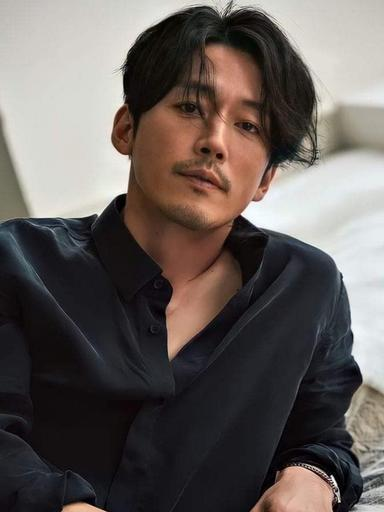

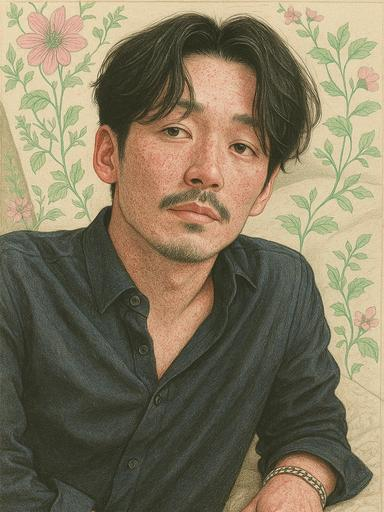

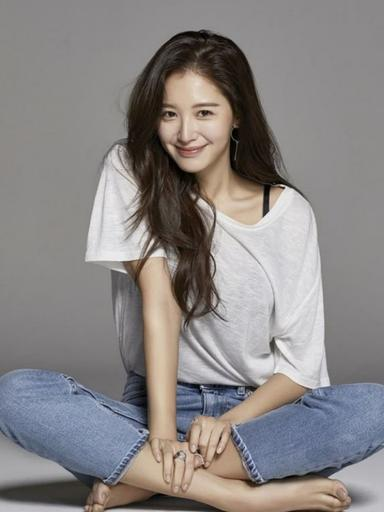


=== Generated image ===


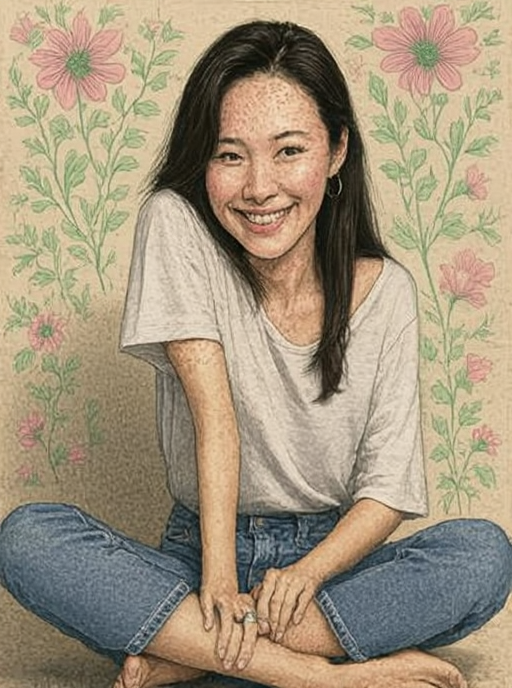

In [ ]:
# Cell 7: define a demo task (manually specify image paths + prompt)

image_paths = [
    "./samples/relation1.jpg", 
    "./samples/relation2.jpg",
    "./samples/relation3.jpg",
]

prompt = "Transform the photo<image_3> into a stylized illustration with a floral patterned background, as the transformation from <image_1> to <style>style reference<image_2>"

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="relation_transfer",
)


100%|██████████| 49/49 [01:15<00:00,  1.54s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/relation_transfer1_img_generated.jpg

=== Input images ===


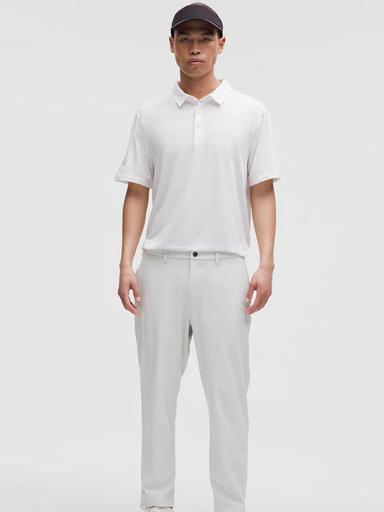

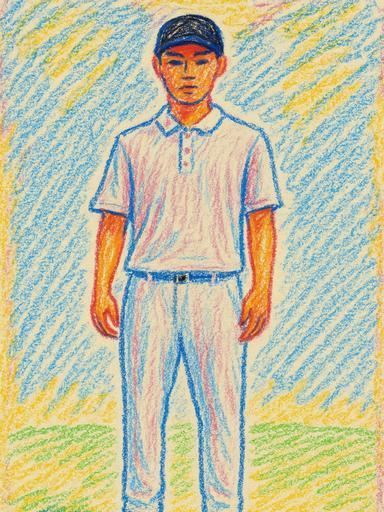

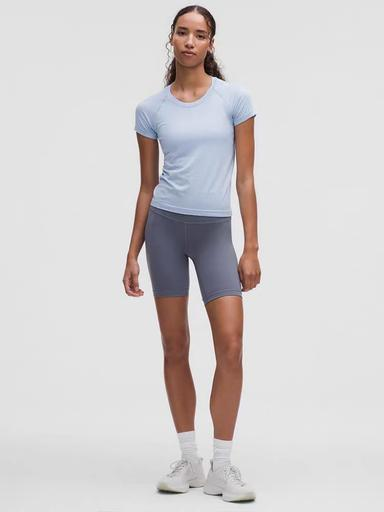


=== Generated image ===


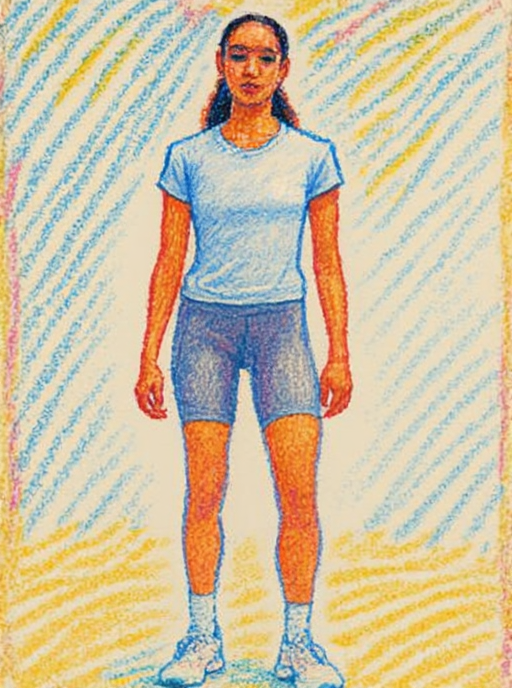

In [ ]:
# Cell 7: define a demo task (manually specify image paths + prompt)

image_paths = [
    "./samples/test_sample15_img_0.jpg",  
    "/./samples/test_sample15_img_1.jpg",
    "./samples/test_sample15_img_2.jpg",
]

prompt = "Apply a crayon drawing style to the real-world <image_3>. Transform all elements into soft, hand-drawn textures with visible crayon strokes, slightly uneven coloring, and sketch-like outlines, as the transformation from <image_1> to <style>style reference<image_2>"

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="relation_transfer1",
)


Saved instruction -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/style_transfer_01_instruction.txt
Saved input image 0 -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/style_transfer_01_img_0.jpg


100%|██████████| 49/49 [02:12<00:00,  2.71s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/style_transfer_01_img_generated.jpg

=== Input images ===


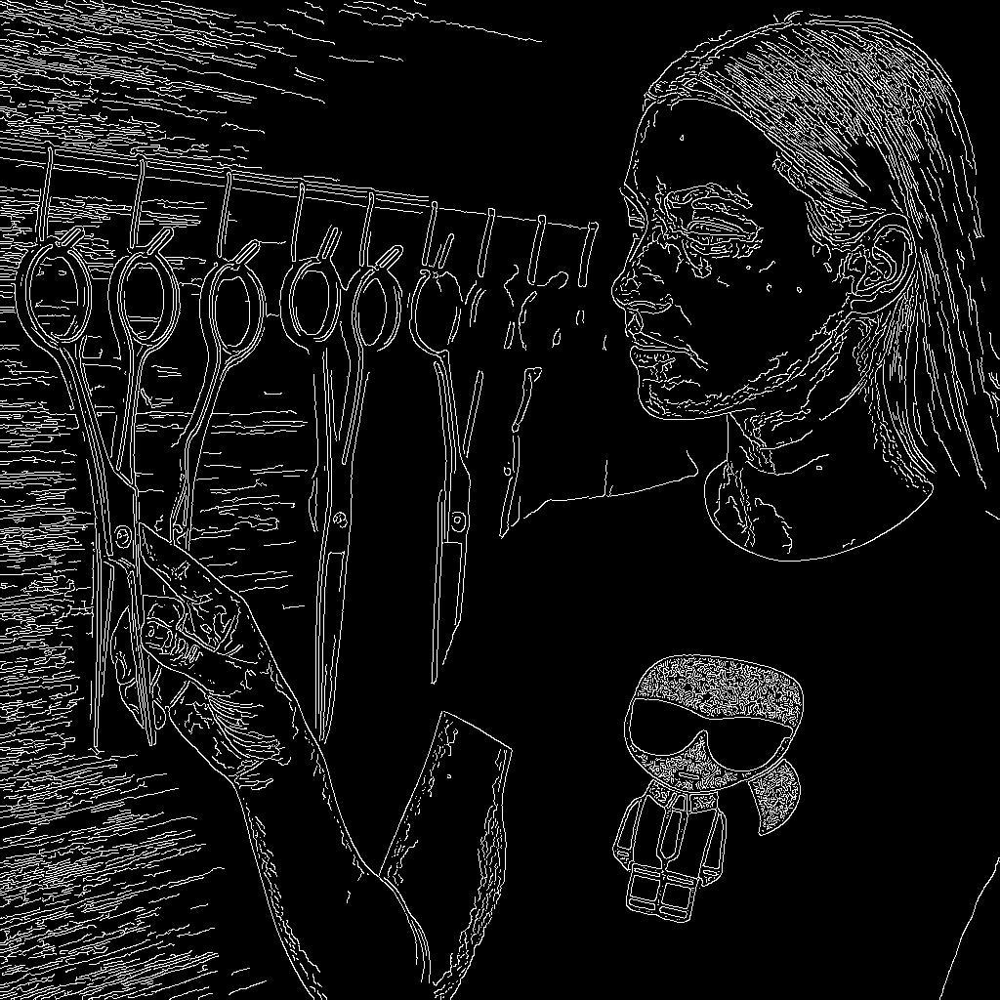


=== Generated image ===


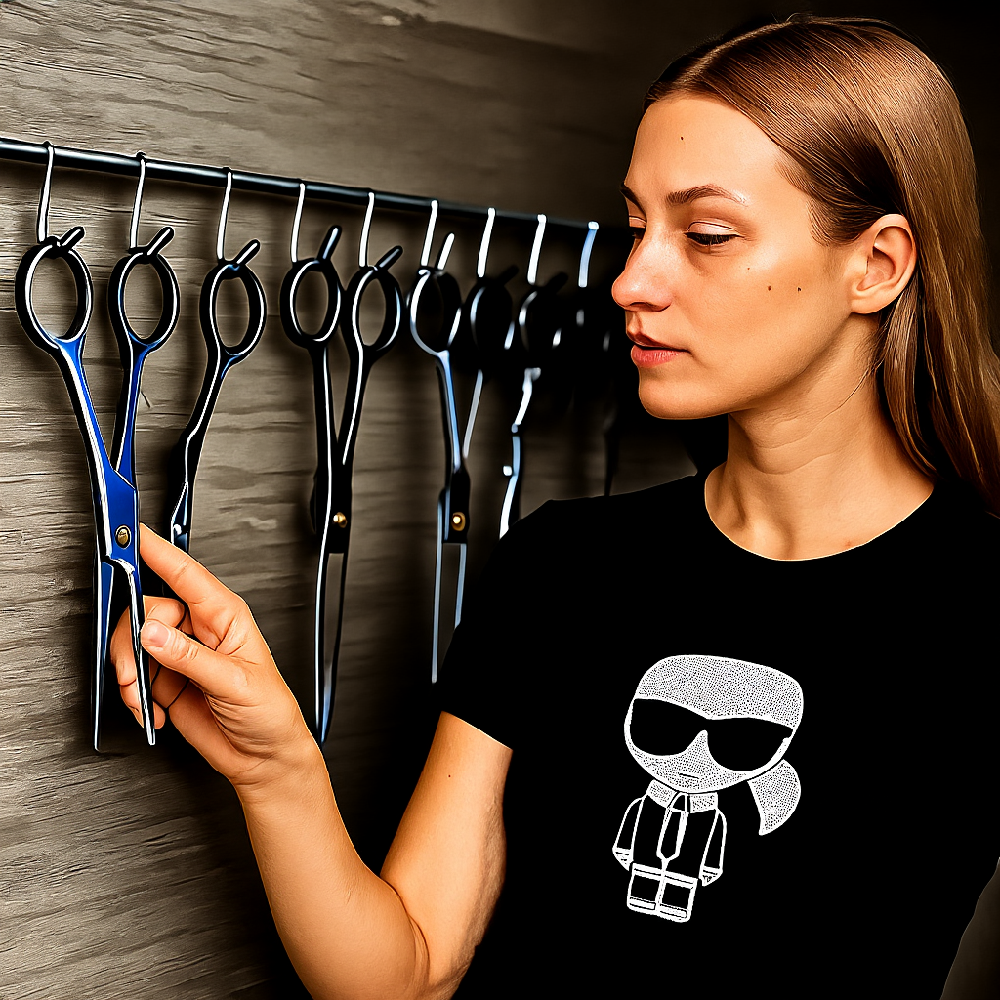

In [ ]:
# Cell 6: define a demo task (manually specify image paths + prompt)

image_paths = [
    "./samples/woman_layout.jpg",  
]

prompt = "Generate the realistic image based on the <layout>canny map <image_1>."

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="style_transfer_01",
)


100%|██████████| 49/49 [01:30<00:00,  1.84s/it]


Saved generated image -> /fi-lib/workspace/zxy/code/Bagel_lora_copy/results/layout_reference_img_generated.jpg

=== Input images ===


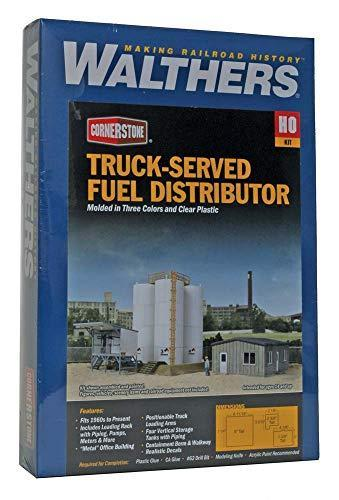

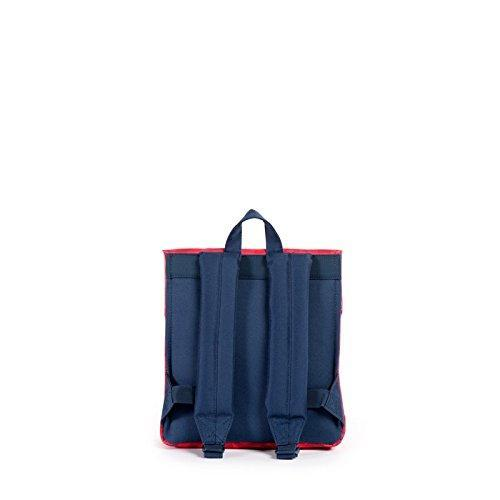

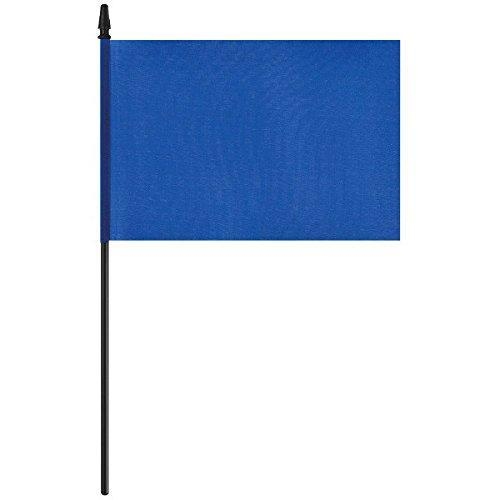

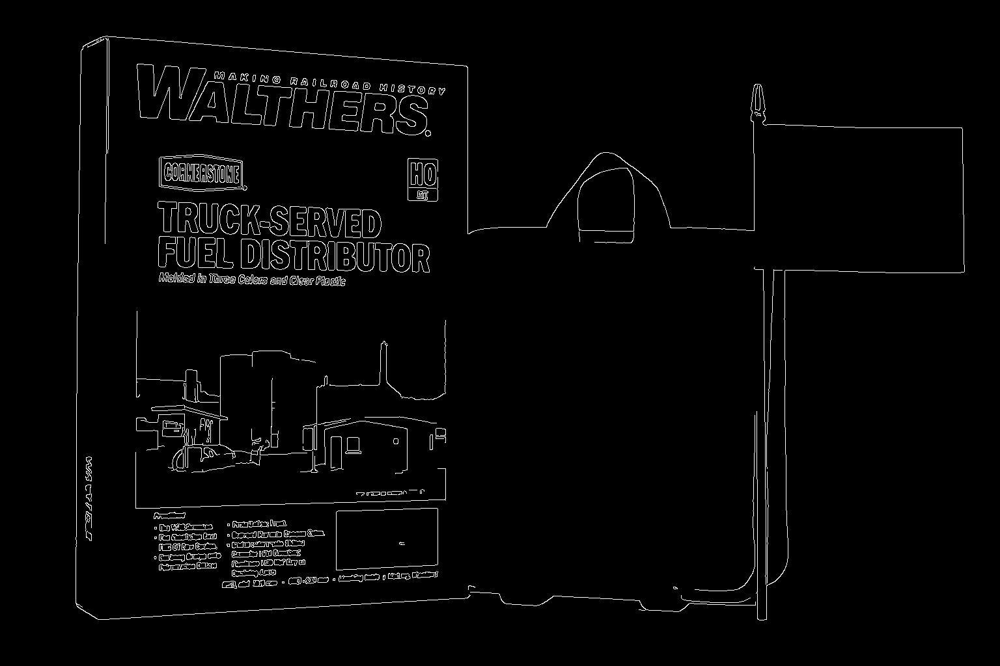


=== Generated image ===


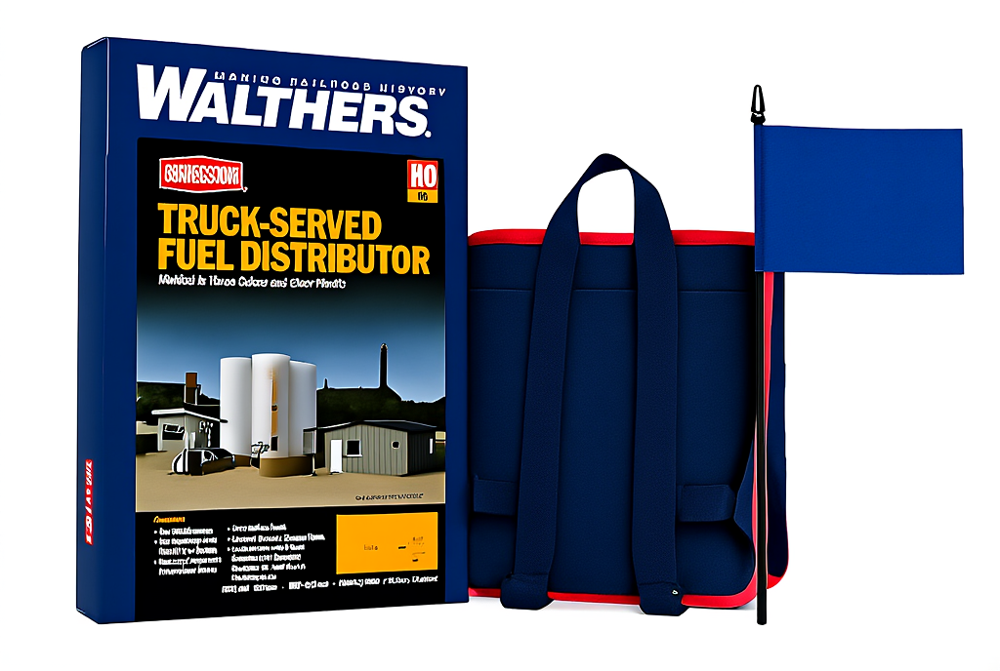

In [ ]:
# Cell 7: define a demo task (manually specify image paths + prompt)


image_paths = [
    "./samples/book.jpg",  
    "./samples/bag.jpg",
    "./samples/flag.jpg",
    "./samples/layout_object.jpg",
]

prompt = "Generate a product bundle image by combining the given product images <subject>product<image_1>, <subject>product<image_2>, and <subject>product<image_3> in a creative and appealing way. Generated image should follow the <layout>layout <image_4>."

output_dir = "./results"

generated_img = generate_image_from_inputs(
    prompt=prompt,
    image_paths=image_paths,
    inferencer=inferencer,
    output_dir=output_dir,
    inference_hyper=config["inference_hyper"],
    sample_name="layout_reference",
)
